In [1]:
import os

import torch
import torch_geometric as pyg
from tqdm.notebook import tqdm

import dataset
import model
import rollout
import visualize

In [2]:
# sample config
config = {
    "data_path": "datasets/WaterDrop",
    "epoch": 1,                             
    "batch_size": 2,                        
    "lr": 1e-3,                             
    "num_workers": 2,                       
    "noise": 3e-4,                 
    "eval_interval": 1000,            
    "rollout_interval": 1000000,  
    "vis_interval": 10000000,             
    "save_interval": 1000,            
    "output_path": "output",      
}

In [3]:
# load onestep datasets
train_dataset = dataset.OneStepDataset(
    config["data_path"], "train", noise_std=config["noise"]
)[:10000]
valid_dataset = dataset.OneStepDataset(
    config["data_path"], "valid", noise_std=config["noise"]
)[:100]
print(train_dataset[0])
print(valid_dataset[0])

Data(x=[678], edge_index=[2, 4410], edge_attr=[4410, 3], y=[678, 2], pos=[678, 14])
Data(x=[482], edge_index=[2, 3076], edge_attr=[3076, 3], y=[482, 2], pos=[482, 14])


In [4]:
# setup dataloaders
train_loader = pyg.loader.DataLoader(
    train_dataset,
    batch_size=config["batch_size"],
    shuffle=True,
    pin_memory=True, # only beneficial when training on GPU
    num_workers=config["num_workers"],
)
valid_loader = pyg.loader.DataLoader(
    valid_dataset,
    batch_size=config["batch_size"],
    shuffle=False,
    pin_memory=True, # only beneficial when training on GPU
    num_workers=config["num_workers"],
)
for x in train_loader:
    print(x)
    break
for x in valid_loader:
    print(x)
    break

DataBatch(x=[859], edge_index=[2, 6789], edge_attr=[6789, 3], y=[859, 2], pos=[859, 14], batch=[859], ptr=[3])
DataBatch(x=[964], edge_index=[2, 6114], edge_attr=[6114, 3], y=[964, 2], pos=[964, 14], batch=[964], ptr=[3])


In [5]:
# load rollout dataset
rollout_dataset = dataset.RolloutDataset(config["data_path"], "valid")[:2]
rollout_dataset[0].keys()
for k,v in rollout_dataset[0].items():
    print(k, v.shape, v.dtype)

particle_type torch.Size([482]) torch.int64
position torch.Size([1001, 482, 2]) torch.float32


In [6]:
# visualize example rollout

%matplotlib inline
import matplotlib.pyplot as plt
from visualize import visualize_single
from IPython.display import HTML

plt.ioff()
rollout_ex = rollout_dataset[1]
ani = visualize_single(rollout_ex["particle_type"], rollout_ex["position"], rollout_dataset.metadata)
HTML(ani.to_jshtml())

In [7]:
# init model
simulator = model.LearnedSimulator(   
    hidden_size=32,
    n_mp_layers=2
)
simulator

LearnedSimulator(
  (embed_type): Embedding(9, 16)
  (node_in): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=30, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=32, bias=True)
      (5): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
    )
  )
  (edge_in): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=3, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=32, bias=True)
      (5): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
    )
  )
  (node_out): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=32, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=2, bias=True)
    

In [8]:
from train import train

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device", device)
simulator = simulator.to(device)

train_loss_list, eval_loss_list, onestep_mse_list, rollout_mse_list = train(config, simulator, train_loader, valid_loader, rollout_dataset, rollout_dataset.metadata, device)

Using device cuda


Epoch 0:   0%|          | 0/5000 [00:00<?, ?it/s]

Epoch 0:  20%|██        | 1007/5000 [00:25<03:30, 18.93it/s, loss=0.203, avg_loss=0.31, lr=0.001]  


Eval: Loss: 0.44973452866077424, One Step MSE: 8.593813298318764e-08


Epoch 0:  40%|████      | 2004/5000 [00:48<02:57, 16.85it/s, loss=0.102, avg_loss=0.249, lr=0.000999] 


Eval: Loss: 0.3436733505129814, One Step MSE: 6.553238204531909e-08


Epoch 0:  60%|██████    | 3004/5000 [01:10<01:57, 16.96it/s, loss=0.1, avg_loss=0.223, lr=0.000999]   


Eval: Loss: 0.34414236426353456, One Step MSE: 6.573946084387217e-08


Epoch 0:  80%|████████  | 4003/5000 [01:33<01:11, 13.85it/s, loss=0.156, avg_loss=0.208, lr=0.000998] 


Eval: Loss: 0.31390796959400175, One Step MSE: 5.990555749235681e-08


Epoch 0: 100%|██████████| 5000/5000 [01:54<00:00, 43.80it/s, loss=0.365, avg_loss=0.197, lr=0.000998] 


Eval: Loss: 0.31061548441648484, One Step MSE: 5.928231459506605e-08


<Figure size 500x500 with 0 Axes>

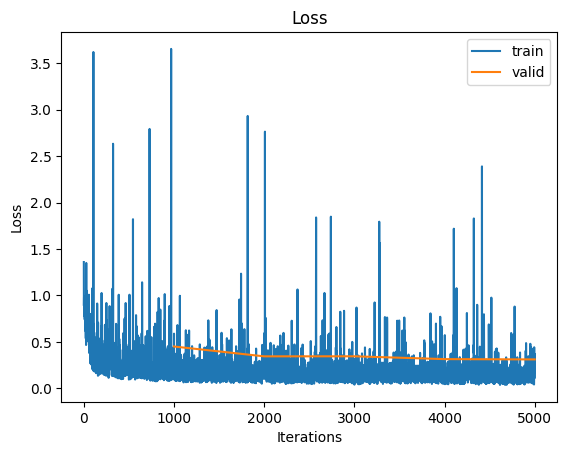

In [9]:
# plot loss
plt.clf()
plt.figure()
plt.plot(*zip(*train_loss_list), label="train")
plt.plot(*zip(*eval_loss_list), label="valid")
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Loss')
plt.legend()
plt.show()

<Figure size 640x480 with 0 Axes>

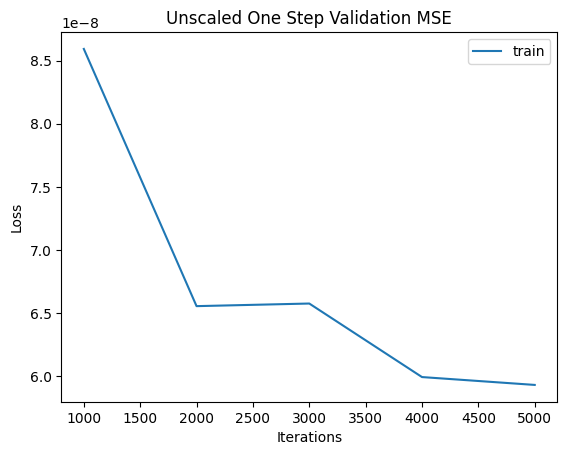

In [10]:
# plot oneStepMSE
plt.clf()
plt.figure()
plt.plot(*zip(*onestep_mse_list), label="train")
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Unscaled One Step Validation MSE')
plt.legend()
plt.show()

/tmp/ipykernel_55504/1706498207.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


<Figure size 640x480 with 0 Axes>

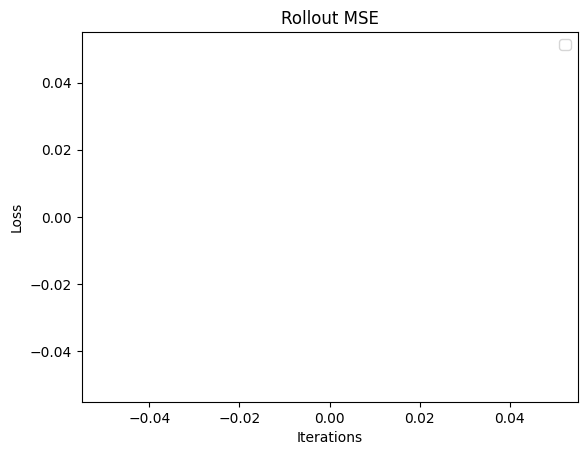

In [11]:
# plot rolloutMSE
plt.clf()
plt.figure()
plt.plot(*zip(*rollout_mse_list), label="train")
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Rollout MSE')
plt.legend()
plt.show()

In [12]:
# visualize rollout
from visualize import visualize_pair

simulator.eval()
rollout_data = rollout_dataset[1]
rollout_out = rollout.rollout(simulator, rollout_data, rollout_dataset.metadata, config["noise"])
rollout_out = rollout_out.permute(1, 0, 2)
plt.clf()
ani = visualize.visualize_pair(rollout_data["particle_type"], rollout_out, rollout_data["position"], rollout_dataset.metadata)
HTML(ani.to_jshtml())